<h3>Packages</h3>

In [1]:
import torch
import torchvision
from PIL import Image, ImageDraw
from torchvision import models
from torch.nn import functional as F
import torch.nn as nn
from torchvision import datasets
from torchvision import transforms
from torchvision import utils
import matplotlib.pyplot as plt
import cv2 as cv
import numpy as np
import imagesize
from torch.utils import data
import torch.optim as optim
import tqdm
from sklearn.metrics import classification_report,confusion_matrix
import seaborn as sns
import os
from pathlib import Path
import pandas as pd
from torch.utils.data import SubsetRandomSampler,DataLoader,Dataset

In [2]:
np.random.seed(0)
torch.manual_seed(0)

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [4]:
mag = "100X" #Options 40X, 100X, 200X, 400X
dataset_name = 'BreakHis'

In [5]:
#data_path = 'BreakHis/fold1_seperated_2_classes/train/40X'
training_dataset_path = dataset_name + '/fold1_seperated_2_classes/train/' + mag
testing_dataset_path = dataset_name + '/fold1_seperated_2_classes/test/' + mag

In [6]:
img_path = 'BreakHis/fold1_seperated_2_classes/test/100X/Malignant/SOB_M_DC-14-11520-100-002.png'
img = Image.open(img_path)

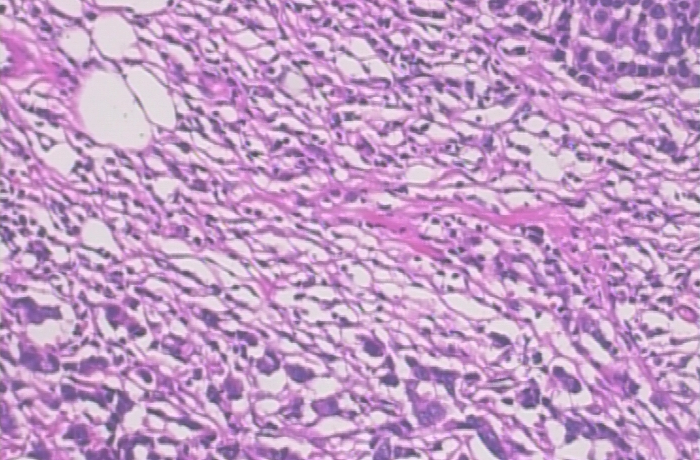

In [ ]:
img

In [8]:
classes = os.listdir(dataset_name + '/fold1_seperated_2_classes/train/' + mag)
classes

['Benign', 'Malignant']

In [9]:
def image_transform(num):
  match num:
    case 1: #40X
      transform = transforms.Compose([
        transforms.Resize((512,512)),
        transforms.ToTensor(),
        transforms.Normalize(
        mean =  [0.8058, 0.6418, 0.7678],
        std = [0.0880, 0.1171, 0.0879])
        ])
    case 2: #100X
        transform = transforms.Compose([
        transforms.Resize((512,512)),
        transforms.ToTensor(),
        transforms.Normalize(mean = [0.8004, 0.6275, 0.7693],
                            std = [0.1012, 0.1368, 0.0902])
        ])
    case 3: #200X
        transform = transforms.Compose([
        transforms.Resize((512,512)),
        transforms.ToTensor(),
          transforms.Normalize(mean = [0.7920, 0.6120, 0.7663], std = [0.1043, 0.1375, 0.0836])
        ])
    case 4:  #400X
        transform = transforms.Compose([
        transforms.Resize((512,512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.7590, 0.5809, 0.7404],std = [0.1195, 0.1602, 0.0887])
        ])
    
  return transform

In [10]:
transform = image_transform(2) # Options (1:40X ,2:100X ,3:200X, 4:400X) 

In [11]:
def load_dataset(path,transform_img):
  data = torchvision.datasets.ImageFolder(root=path, transform=transform)
  return data

In [ ]:
training_dataset = load_dataset(training_dataset_path,transform)
training_dataset

Dataset ImageFolder
    Number of datapoints: 1321
    Root location: BreakHis/fold1_seperated_2_classes/train/100X
    StandardTransform
Transform: Compose(
               Resize(size=(512, 512), interpolation=bilinear, max_size=None, antialias=True)
               ToTensor()
               Normalize(mean=[0.8004, 0.6275, 0.7693], std=[0.1012, 0.1368, 0.0902])
           )

In [ ]:
testing_dataset = load_dataset(testing_dataset_path,transform)
testing_dataset

Dataset ImageFolder
    Number of datapoints: 760
    Root location: BreakHis/fold1_seperated_2_classes/test/100X
    StandardTransform
Transform: Compose(
               Resize(size=(512, 512), interpolation=bilinear, max_size=None, antialias=True)
               ToTensor()
               Normalize(mean=[0.8004, 0.6275, 0.7693], std=[0.1012, 0.1368, 0.0902])
           )

In [14]:
'''def compute_std_mean(loader):
    mean = 0.
    std = 0.
    total=0
    for images,labels in loader:
        images_in_a_batch = images.shape[0]
        images = images.view(images.shape[0],images.shape[1],-1)
        mean+=images.mean(2).sum(0)
        std+=images.std(2).sum(0)
        total+=images_in_a_batch
    
    mean/=total
    std/=total
    
    return mean,std'''

'def compute_std_mean(loader):\n    mean = 0.\n    std = 0.\n    total=0\n    for images,labels in loader:\n        images_in_a_batch = images.shape[0]\n        images = images.view(images.shape[0],images.shape[1],-1)\n        mean+=images.mean(2).sum(0)\n        std+=images.std(2).sum(0)\n        total+=images_in_a_batch\n    \n    mean/=total\n    std/=total\n    \n    return mean,std'

In [15]:
train_loader = torch.utils.data.DataLoader(dataset = training_dataset, batch_size = 16,shuffle=True)

In [16]:
#mean,std = compute_std_mean(train_loader)
#print(f'Mean: {mean} Std: {std}')

In [17]:
#Splitting Training Data into Training and Validation
dataset_size = len(testing_dataset)
dataset_indices = list(range(dataset_size))
np.random.shuffle(dataset_indices)
val_split_index = int(np.floor(0.3 * dataset_size)) #0.3 - 30:70 Ratio
train_idx, val_idx = dataset_indices[val_split_index:], dataset_indices[:val_split_index]
test_sampler = SubsetRandomSampler(train_idx)
val_sampler = SubsetRandomSampler(val_idx)
test_loader = torch.utils.data.DataLoader(dataset = testing_dataset,batch_size = 16,sampler=test_sampler,shuffle=False)
val_loader = DataLoader(dataset= testing_dataset, shuffle=False, batch_size=16, sampler=val_sampler)

<h3>Training Model</h3>

In [18]:
model = torchvision.models.resnet50(pretrained=True)
model_name = 'resnet50'

c:\Users\Utkarsh Varman\torch3913\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Utkarsh Varman\torch3913\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [19]:
#Output Layer Modification
num_ftrs = model.fc.in_features
num_classes = 2
model.fc = nn.Linear(num_ftrs, num_classes,bias=True)

In [20]:
model = model.to(device)

In [21]:
#model

In [22]:
criterion = nn.CrossEntropyLoss()
optimizer_ft = optim.SGD(model.parameters(), lr=0.001, momentum=0.9,weight_decay = 0.03)
N_EPOCHS = 100

In [23]:
X = transform(img).unsqueeze_(0)

In [24]:
model(X.to(device))

tensor([[0.5061, 0.1652]], device='cuda:0', grad_fn=<AddmmBackward0>)

In [25]:
model_path = 'Models/' + mag + '_' + dataset_name + '_' + model_name + '.pth'
print(model_path)

Models/100X_BreakHis_resnet50.pth


In [26]:
def set_device():
  if torch.cuda.is_available():
    dev = 'cuda:0'
  else:
    dev = 'cpu'
  return torch.device(dev)

In [27]:
import time
def train_nn(model, train_loader, test_loader,criterion,optimizer,n_epochs):
  device = set_device()
  best_acc = 0
  train_losses = []
  train_acc = []
  val_acc = []
  val_losses = []
  max_epoch_time = 0.0
  model = model.to(device)
  for epoch in range(n_epochs):
    start_time = time.time()
    print("Epoch number: %d"%(epoch+1))
    model.train()
    running_loss = 0.0
    running_correct = 0.0
    total = 0
    for data in train_loader:
      images,labels = data
      images = images.to(device) #for faster processing
      labels = labels.to(device)
      total += labels.size(0)

      optimizer.zero_grad() #Set grad = 0 before back prop
      outputs = model(images)

      _,predicted = torch.max(outputs.data,1)

      loss = criterion(outputs,labels)
      loss.backward() #Calculate Weight gradients
      optimizer.step() #update weights
      running_loss += loss.item()
      running_correct += (labels==predicted).sum().item()
      
    

    epoch_loss = running_loss/len(train_loader)
    epoch_acc = 100.0*running_correct/total
    train_losses.append(epoch_loss)
    train_acc.append(epoch_acc)

    print("  -Training Dataset, Got %d out of %d images correctly (%0.3f%%). Epoch Loss: %0.3f"%(running_correct, total, epoch_acc,epoch_loss))
    test_dataset_acc, test_dataset_loss = evaluate_model(model,test_loader,criterion)
    val_acc.append(test_dataset_acc)
    val_losses.append(test_dataset_loss) 

    end_time = time.time()
    epoch_time = end_time - start_time
    max_epoch_time = max(max_epoch_time,epoch_time)

    if (test_dataset_acc>best_acc):
        best_acc = test_dataset_acc
        save_checkpoint(model,epoch,optimizer,best_acc,train_losses, train_acc, val_losses,val_acc,max_epoch_time)

  print('Finished Training')
  print(f'Model Saved at {model_path}')
  return model,train_losses,train_acc,val_acc,val_losses

In [28]:
def save_checkpoint(model, epoch, optimizer, best_acc, train_losses, train_acc, val_losses, val_acc,epoch_time):
    state = {
        'epoch': epoch + 1,
        'model': model.state_dict(),
        'best accuracy': best_acc,
        'optimizer': optimizer.state_dict(),
        'train_losses': train_losses,
        'train_acc': train_acc,
        'val_losses': val_losses,
        'val_acc': val_acc,
        'max_epoch_time':epoch_time
    }
    torch.save(state, model_path)

In [29]:
def evaluate_model(model,test_loader,criterion):  
    model.eval()
    predicted_correctly = 0
    total = 0
    device = set_device()
    running_loss = 0.0

    with torch.no_grad(): #Used for not backpropogating which improves computation speed
          for data in test_loader:
            images,labels = data
            images = images.to(device)
            labels = labels.to(device)
            total += labels.size(0) #total amount of images

            outputs = model(images)

            _,predicted = torch.max(outputs.data,1)
            loss = criterion(outputs,labels)
            running_loss+=loss.item()

            predicted_correctly+=(predicted==labels).sum().item()
    epoch_acc = 100.0*predicted_correctly/total
    epoch_loss = running_loss/len(test_loader)
    print('-  Testing dataset. Got %d out of %d images correctly (%0.3f%%). Loss: %0.3f' % (predicted_correctly, total, epoch_acc,epoch_loss))
    return epoch_acc,epoch_loss


In [30]:
#Train the model
#history, train_losses, train_acc, val_acc,val_losses = train_nn(model, train_loader,val_loader, criterion, optimizer_ft ,N_EPOCHS)

<h3>Load the Model</h3>

In [31]:
check = torch.load(model_path,map_location=torch.device(device)) #model in dictionary

C:\Users\Utkarsh Varman\AppData\Local\Temp\ipykernel_14416\1892383017.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check = torch.load(model_path,map_location=torch.de

In [32]:
check['best accuracy'] #Print best model accuracy during training

94.73684210526316

In [33]:
#Extract model from dictionary and save it in a dir
model.load_state_dict(check['model'])

<All keys matched successfully>

In [34]:
model.eval()
model = model.to(device)

In [35]:
def evaluate_model(model,test_loader,criterion):
    model.eval()
    predicted_correctly = 0
    total = 0
    device = set_device()
    running_loss = 0.0
    with torch.no_grad(): #Used for not backpropogating which improves computation speed
          for data in test_loader:
            images,labels = data
            images = images.to(device)
            labels = labels.to(device)
            total += labels.size(0) #total amount of images

            outputs = model(images)

            _,predicted = torch.max(outputs.data,1)
            loss = criterion(outputs,labels)
            running_loss+=loss.item()

            predicted_correctly+=(predicted==labels).sum().item()
    epoch_acc = 100.0*predicted_correctly/total
    epoch_loss = running_loss/len(test_loader)
    print('-  Testing dataset. Got %d out of %d images correctly (%0.3f%%). Loss: %0.3f' % (predicted_correctly, total, epoch_acc,epoch_loss))

    return epoch_acc,epoch_loss

In [36]:
#evaluate_model(model,test_loader,criterion)

In [38]:
evaluate_model(model,train_loader,criterion)

-  Testing dataset. Got 1321 out of 1321 images correctly (100.000%). Loss: 0.003


(100.0, 0.002717138944805252)

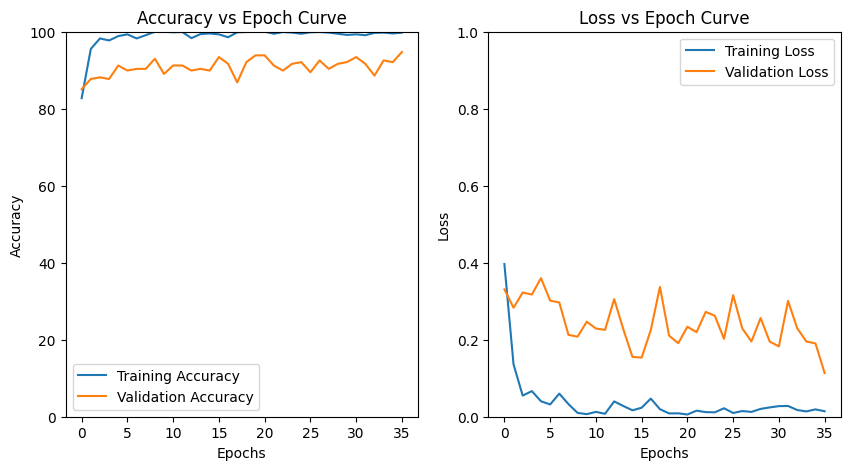

In [36]:
# Create a folder to save the plots if it doesn't exist
folder_path = 'Graphs/' + mag + "/" + model_name + '_' + dataset_name
if not os.path.exists(folder_path):
    os.makedirs(folder_path)

plt.figure(figsize=(10, 5))
plt.subplot(1,2,1)
plt.plot(check['train_acc'], label='Training Accuracy')
plt.plot(check['val_acc'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.ylim(0,100)
plt.title('Accuracy vs Epoch Curve')
plt.legend()

plt.subplot(1,2,2)     
plt.plot(check['train_losses'],label='Training Loss')
plt.plot(check['val_losses'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.ylim(0,1)
plt.title('Loss vs Epoch Curve')
plt.legend()
plt.savefig(os.path.join(folder_path, 'curves_' + mag + "_" + model_name + '.png'))

In [39]:
def evaluate_model_classification_report(model, test_loader):
    model.eval()
    true_labels = []
    predicted_labels = []
    device = set_device()

    with torch.no_grad():
        for data in test_loader:
            images, labels = data
            images = images.to(device)
            labels = labels.to(device)
            true_labels.extend(labels.cpu().numpy())

            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            predicted_labels.extend(predicted.cpu().numpy())

    return true_labels, predicted_labels

In [40]:
true_labels, predicted_labels = evaluate_model_classification_report(model, test_loader)
from sklearn.metrics import classification_report,roc_auc_score
print(classification_report(true_labels, predicted_labels))

              precision    recall  f1-score   support

           0       0.92      0.88      0.90       182
           1       0.94      0.96      0.95       350

    accuracy                           0.93       532
   macro avg       0.93      0.92      0.93       532
weighted avg       0.93      0.93      0.93       532



In [43]:
auc_score = roc_auc_score(true_labels, predicted_labels)
print("AUC Score:", auc_score)

AUC Score: 0.9223076923076923


In [42]:
from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(true_labels, predicted_labels)
print(f"Confusion Matrix:\n{conf_matrix}")
tn, fp, fn, tp = conf_matrix.ravel()
print(f"True Positives (TP): {tp}")
print(f"True Negatives (TN): {tn}")
print(f"False Positives (FP): {fp}")
print(f"False Negatives (FN): {fn}")

Confusion Matrix:
[[161  21]
 [ 14 336]]
True Positives (TP): 336
True Negatives (TN): 161
False Positives (FP): 21
False Negatives (FN): 14


In [38]:
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [39]:
def classify(model,image_transforms,image_path, classes,device):
  model = model.to(device)
  image = Image.open(image_path)
  image = image_transforms(image).to(device)
  image = image.unsqueeze(0)
  output = model(image)
  _,predicted = torch.max(output,1)
  print("Original Classification:",classes[predicted.item()])

def GradCAM(model,img,transform):
  X = transform(img)
  X.unsqueeze_(0)
  X = X.to(device)
  print(X.shape)
  logits = model(X)

  _,index = torch.max(logits,dim=1)
  per = torch.nn.functional.softmax(logits,dim=1)[0]*100
  logits[:,index.item()].backward()
  print(f"Predicted Class: {classes[index[0]]}")
  print(f"Probability Percentage: {per[index[0]].item():0.2f}%")

  gradients = model.get_gradients()
  pooled_gradients  = torch.mean(gradients, dim=[0,2,3])
  feature_maps = model.get_featuremaps(X).detach()

  for i in range(2048):
    feature_maps[:,i,:,:] *= pooled_gradients[i]

  avg_feats = torch.mean(feature_maps, dim=1).squeeze()

  return avg_feats

def visualize_heatmap(map):
  map = map.to('cpu')
  map = np.maximum(map, 0)
  map = np.maximum(map, 0)
  map /= (torch.max(map) + 1e-8)
  return map

def visualize_activation_map(heatmap,dim):
  if isinstance(heatmap, torch.Tensor):
    heatmap = heatmap.cpu().numpy()
  heatmap = cv.resize(heatmap, (dim[1],dim[2]))
  heatmap = np.uint8(255 * heatmap)
  heatmap = cv.applyColorMap(heatmap,cv.COLORMAP_JET)
  heatmap = cv.cvtColor(heatmap, cv.COLOR_BGR2RGB)
  return heatmap

def visualize_superimposed(activation_map,img_path,dim):
  img = cv.imread(img_path)
  img = cv.resize(img,(dim[1],dim[2]))
  superimposed_img = activation_map*0.3 + img*0.7
  superimposed_img = np.clip(activation_map * 0.3 + img * 0.7, 0, 255)
  superimposed_img = superimposed_img.astype(np.uint8)
  return superimposed_img

def plot_images(np_img,gradcam_map, save_path: str):
  fig, ax = plt.subplots(1, 2, figsize=(20, 10))  # Create a 1x2 grid to show images
  
  ax[0].imshow(np_img)
  ax[0].set_title("Original Image")
  ax[0].axis("off") 

  ax[1].imshow(gradcam_map)
  ax[1].set_title("Superimposed Gradcam Image")
  ax[1].axis("off")  

  print(f"Image saved at: {save_path}")

  plt.tight_layout()
  plt.savefig(save_path)
  plt.show()
   
   

def generate_xai_gradcam(model_instance,img_fold_path, save_dir):
   for img_name in os.listdir(img_fold_path):
      img_path = os.path.join(img_fold_path,img_name)
      img = Image.open(img_path)
      img = img.resize((512,512))
      X = transform(img).unsqueeze_(0)
      X = X.to(device)
      classify(model, transform, img_path,classes,device)
      print("------ --------")
      dim = transform(img).shape 
      heatmap = GradCAM(model_instance,img,transform)
      gradcam_heatmap = visualize_heatmap(heatmap)
      gradcam_activation_map = visualize_activation_map(gradcam_heatmap,dim)
      gradcam_superimposed = visualize_superimposed(gradcam_activation_map,img_path,dim)
      np_img = np.array(img)[:, :, ::-1]
      plot_images(np_img, gradcam_superimposed, save_path=os.path.join(save_dir,img_name + "_gradcam_output.png"))


In [40]:
mag = "100X"
model_name = "Resnet50"
fold_path_b = 'XAI_all/' + mag + "/Benign"
save_dir = "XAI_images/" + model_name + "/" + mag + "/GradCAM/" + "Benign/"
print(f'{model_name}')
print(f'{fold_path_b}')
print(f'{save_dir}')
print(f'{model_path}')

Resnet50
XAI_all/100X/Benign
XAI_images/Resnet50/100X/GradCAM/Benign/
Models/100X_BreakHis_resnet50.pth


In [41]:
model_instance = Resnet50(model, num_classes = 2)
resnet = model_instance.to(device)
resnet.eval()

Resnet50(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64

In [ ]:
#os.makedirs(save_dir, exist_ok=True)
#grad_cam_result = generate_xai_gradcam(resnet,fold_path_b,save_dir=save_dir)

In [48]:
model_instance = Resnet50(model, num_classes = 2)
resnet = model_instance.to(device)
resnet.eval()

Resnet50(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64

In [49]:

fold_path_m = 'XAI_all/' + mag + "/Malignant"
save_dir = "XAI_images/" + model_name + "/" + mag + "/GradCAM/" + "Malignant/"
print(f'{model_name}')
print(f'{fold_path_m}')
print(f'{save_dir}')
print(f'{model_path}')

Resnet50
XAI_all/100X/Malignant
XAI_images/Resnet50/100X/GradCAM/Malignant/
Models/100X_BreakHis_resnet50.pth


In [64]:
#os.makedirs(save_dir, exist_ok=True)
#grad_cam_result = generate_xai_gradcam(resnet,fold_path_m,save_dir=save_dir)

In [51]:
def classify(model,image_transforms,image_path, classes,device):
  model = model.to(device)
  image = Image.open(image_path)
  image = image_transforms(image).to(device)
  image = image.unsqueeze(0)
  output = model(image)
  _,predicted = torch.max(output,1)
  print("Original Classification:",classes[predicted.item()])

def GradCAMPP(img,transform,model):
  X = transform(img)
  X.unsqueeze_(0)
  X = X.to(device)

  b, c, h, w = X.size()
  logits = model(X)
  _,index = torch.max(logits,dim=1)
  print("Predicted Label:", classes[index[0]])
  score = logits[:,index[0].item()]
  score.backward()
  gradients = model.get_gradients()
  activations = model.get_featuremaps(X).detach()
  b, k, u, v = gradients.size()

  alpha_num = gradients.pow(2)
  alpha_denom = gradients.pow(2).mul(2) + activations.mul(gradients.pow(3)).view(b, k, u*v).sum(-1, keepdim=True).view(b, k, 1, 1)
  alpha_denom = torch.where(alpha_denom != 0.0, alpha_denom, torch.ones_like(alpha_denom))

  alpha = alpha_num.div(alpha_denom+1e-7)
  positive_gradients = F.relu(score.exp()*gradients) # ReLU(dY/dA) == ReLU(exp(S)*dS/dA))
  weights = (alpha*positive_gradients).view(b, k, u*v).sum(-1).view(b, k, 1, 1)

  saliency_map = (weights*activations).sum(1, keepdim=True)
  saliency_map = F.relu(saliency_map)
  saliency_map_min, saliency_map_max = saliency_map.min(), saliency_map.max()
  saliency_map = (saliency_map-saliency_map_min).div(saliency_map_max-saliency_map_min).data

  saliency_map = torch.mean(saliency_map, dim=1).squeeze()

  return saliency_map

def visualize_heatmap(map):
  map = map.to('cpu')
  map = np.maximum(map, 0)
  map = np.maximum(map, 0)
  map /= (torch.max(map) + 1e-8)
  return map

def visualize_activation_map(heatmap,dim):
  if isinstance(heatmap, torch.Tensor):
    heatmap = heatmap.cpu().numpy()
  heatmap = cv.resize(heatmap, (dim[1],dim[2]))
  heatmap = np.uint8(255 * heatmap)
  heatmap = cv.applyColorMap(heatmap,cv.COLORMAP_JET)
  heatmap = cv.cvtColor(heatmap, cv.COLOR_BGR2RGB)
  return heatmap

def visualize_superimposed(activation_map,img_path,dim):
  img = cv.imread(img_path)
  img = cv.resize(img,(dim[1],dim[2]))
  superimposed_img = activation_map*0.3 + img*0.7
  superimposed_img = np.clip(activation_map * 0.3 + img * 0.7, 0, 255)
  superimposed_img = superimposed_img.astype(np.uint8)
  return superimposed_img

def plot_images(np_img,gradcampp_map, save_path: str):
  fig, ax = plt.subplots(1, 2, figsize=(20, 10))  # Create a 1x2 grid to show images
  
  ax[0].imshow(np_img)
  ax[0].set_title("Original Image")
  ax[0].axis("off") 

  ax[1].imshow(gradcampp_map)
  ax[1].set_title("Superimposed GradCAM++ Image")
  ax[1].axis("off")  

  print(f"Image saved at: {save_path}")

  plt.tight_layout()
  plt.savefig(save_path)
  plt.show()
   
   

def generate_xai_gradcampp(model_instance,img_fold_path, save_dir):
   for img_name in os.listdir(img_fold_path):
      img_path = os.path.join(img_fold_path,img_name)
      img = Image.open(img_path)
      img = img.resize((512,512))
      X = transform(img).unsqueeze_(0)
      X = X.to(device)
      classify(model, transform, img_path,classes,device)
      print("------ --------")
      dim = transform(img).shape 
      heatmap_gradcampp = GradCAMPP(img,transform, model_instance)
      heatmap_gradcampp = heatmap_gradcampp.cpu()
      gradcampp_activation_map = visualize_activation_map(heatmap_gradcampp,dim)
      gradcampp_superimposed = visualize_superimposed(gradcampp_activation_map,img_path,dim)
      np_img = np.array(img)[:, :, ::-1]
      plot_images(np_img, gradcampp_superimposed, save_path=os.path.join(save_dir,img_name + "_gradcampp_output.png"))
      



In [54]:
model_instance = Resnet50(model, num_classes = 2)
resnet = model_instance.to(device)
resnet.eval()

Resnet50(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64

In [55]:
mag = "100X"
fold_path_b = 'XAI_all/' + mag + "/Benign"
save_dir = "XAI_images/" + model_name + "/" + mag + "/GradCAMPP/" + "Benign/"
print(f'{model_name}')
print(f'{fold_path_b}')
print(f'{save_dir}')
print(f'{model_path}')

Resnet50
XAI_all/100X/Benign
XAI_images/Resnet50/100X/GradCAMPP/Benign/
Models/100X_BreakHis_resnet50.pth


In [63]:
#os.makedirs(save_dir, exist_ok=True)
#grad_cam_result = generate_xai_gradcampp(resnet,fold_path_b,save_dir=save_dir)

In [58]:
fold_path_m = 'XAI_all/' + mag + "/Malignant"
save_dir = "XAI_images/" + model_name + "/" + mag + "/GradCAMPP/" + "Malignant/"
print(f'{model_name}')
print(f'{fold_path_b}')
print(f'{save_dir}')
print(f'{model_path}')

Resnet50
XAI_all/100X/Malignant
XAI_images/Resnet50/100X/GradCAMPP/Malignant/
Models/100X_BreakHis_resnet50.pth


In [60]:
model_instance = Resnet50(model, num_classes = 2)
resnet = model_instance.to(device)
resnet.eval()

Resnet50(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64

Original Classification: Malignant
------ --------
Predicted Label: Malignant
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-11520-100-005.png_gradcampp_output.png


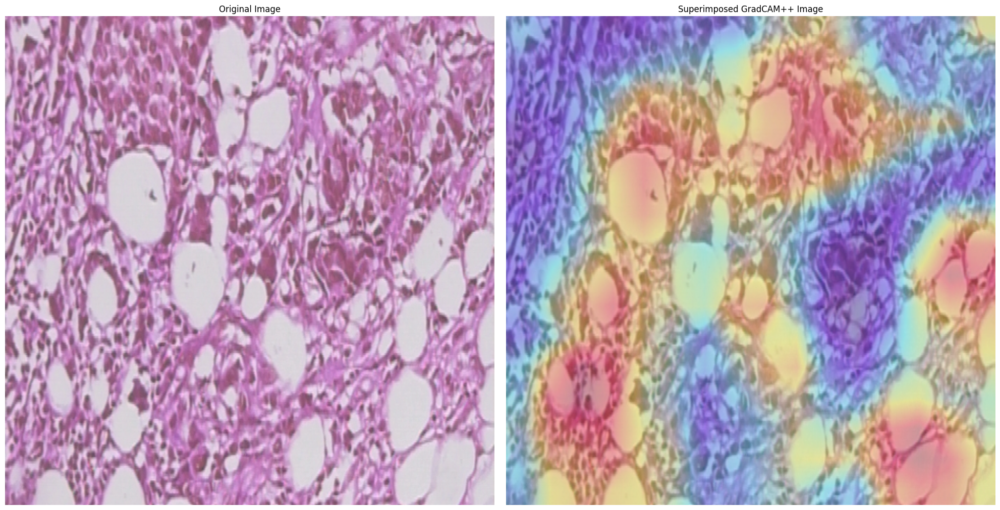

Original Classification: Malignant
------ --------
Predicted Label: Malignant
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-11520-100-006.png_gradcampp_output.png


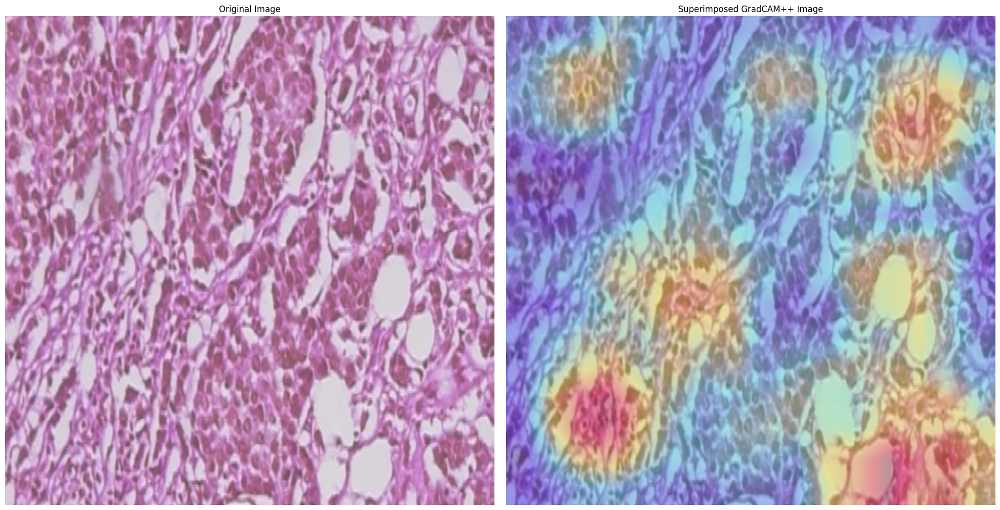

Original Classification: Malignant
------ --------
Predicted Label: Malignant
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-11520-100-023.png_gradcampp_output.png


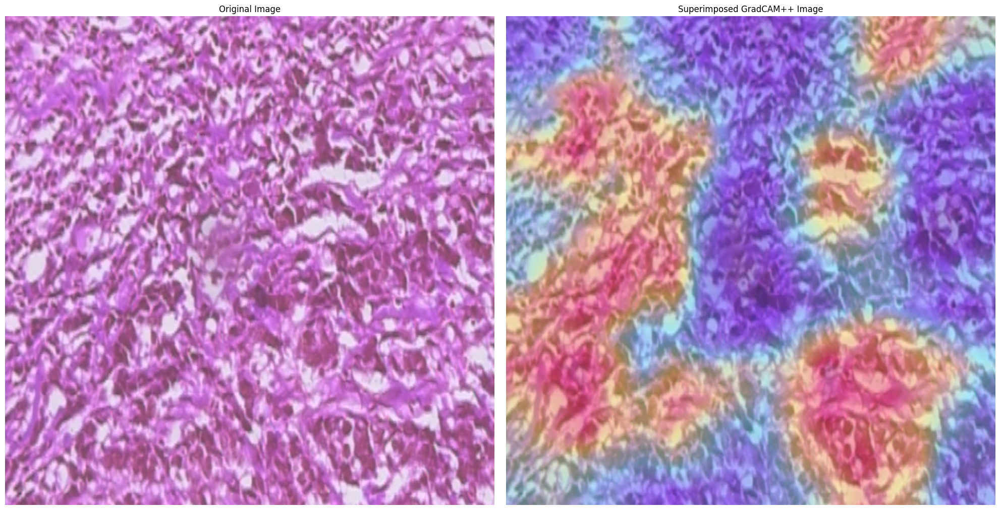

Original Classification: Malignant
------ --------
Predicted Label: Malignant
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-16716-100-009.png_gradcampp_output.png


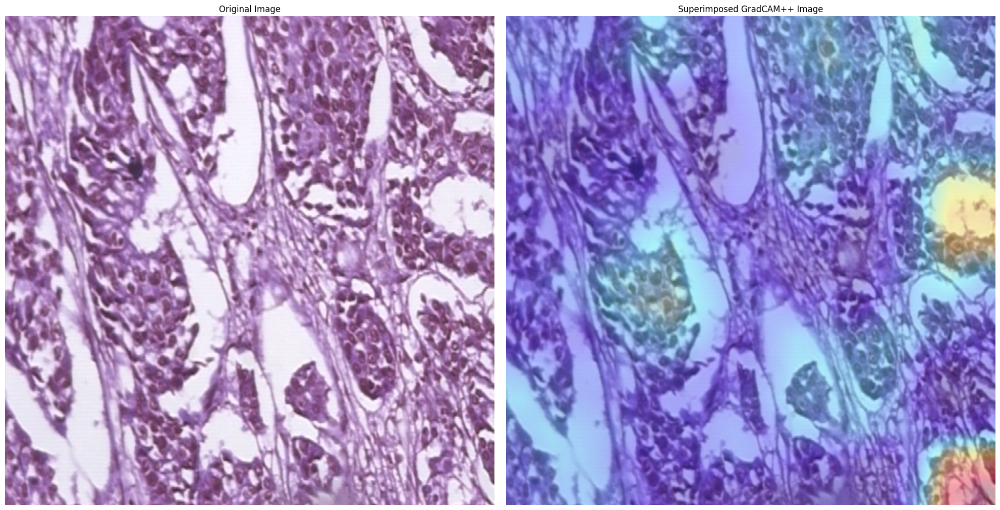

Original Classification: Malignant
------ --------
Predicted Label: Malignant
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-2980-100-001.png_gradcampp_output.png


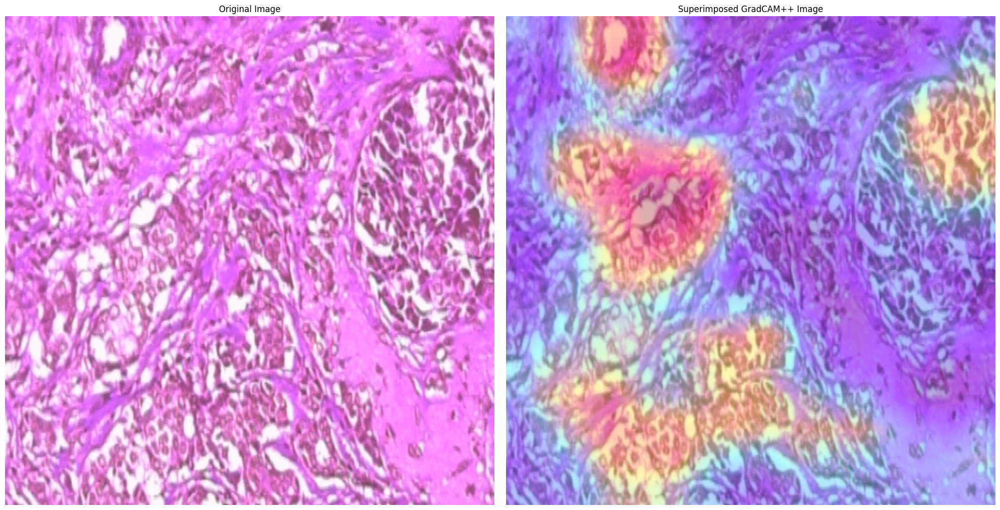

Original Classification: Malignant
------ --------
Predicted Label: Benign
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-2980-100-013.png_gradcampp_output.png


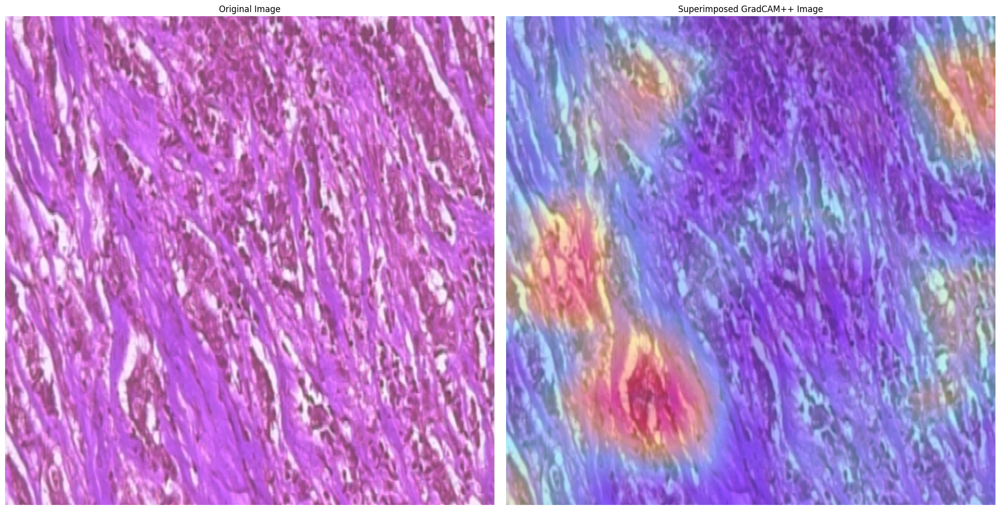

Original Classification: Malignant
------ --------
Predicted Label: Benign
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-2980-100-015.png_gradcampp_output.png


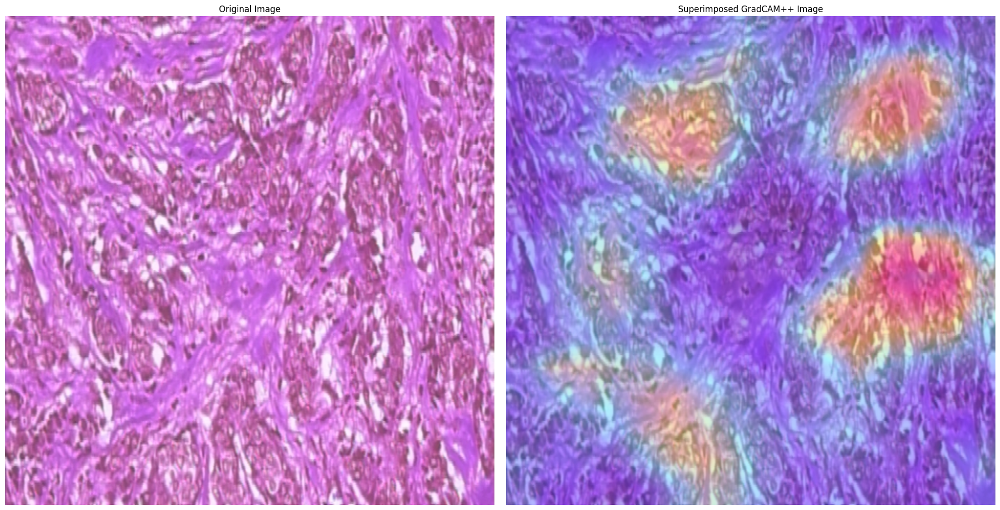

Original Classification: Malignant
------ --------
Predicted Label: Malignant
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-3909-100-006.png_gradcampp_output.png


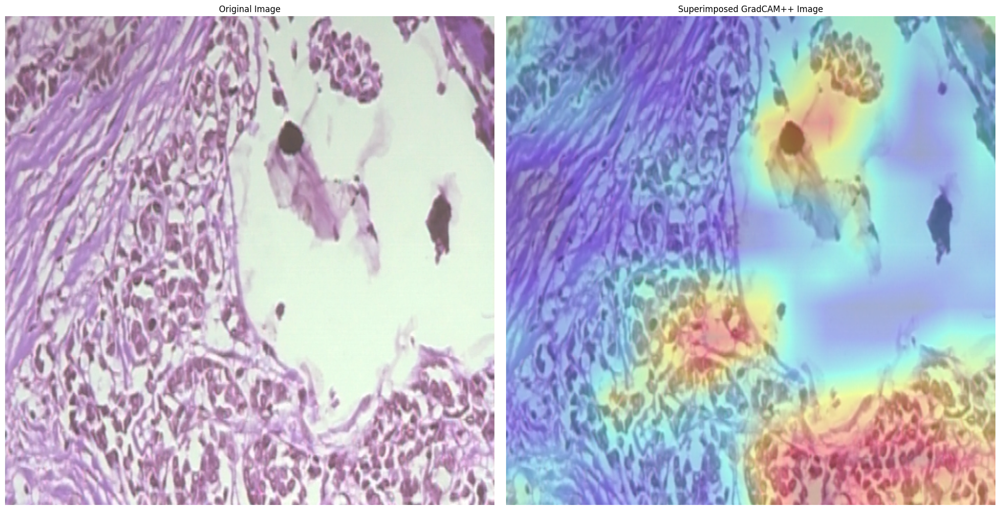

Original Classification: Malignant
------ --------
Predicted Label: Malignant
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-3909-100-007.png_gradcampp_output.png


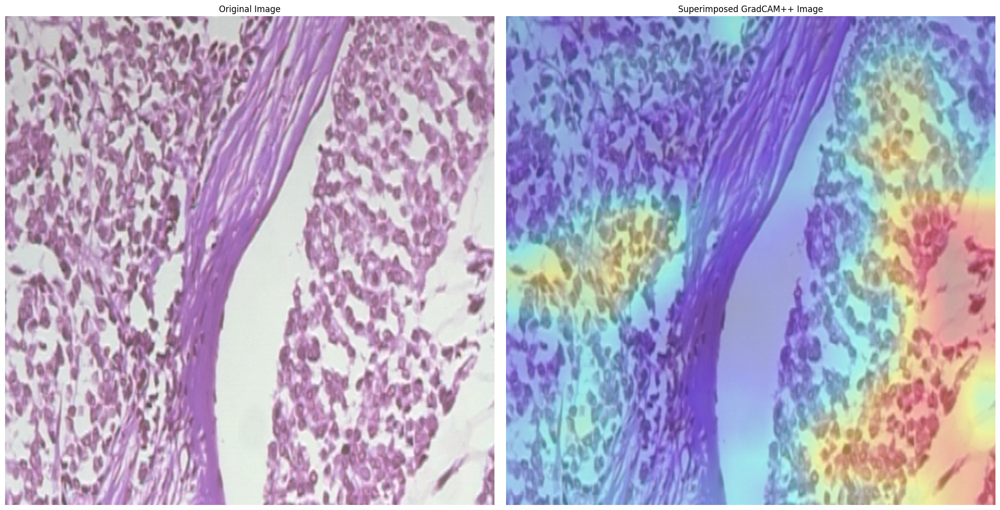

Original Classification: Malignant
------ --------
Predicted Label: Malignant
Image saved at: XAI_images/Resnet50/100X/GradCAMPP/Malignant/SOB_M_DC-14-3909-100-013.png_gradcampp_output.png


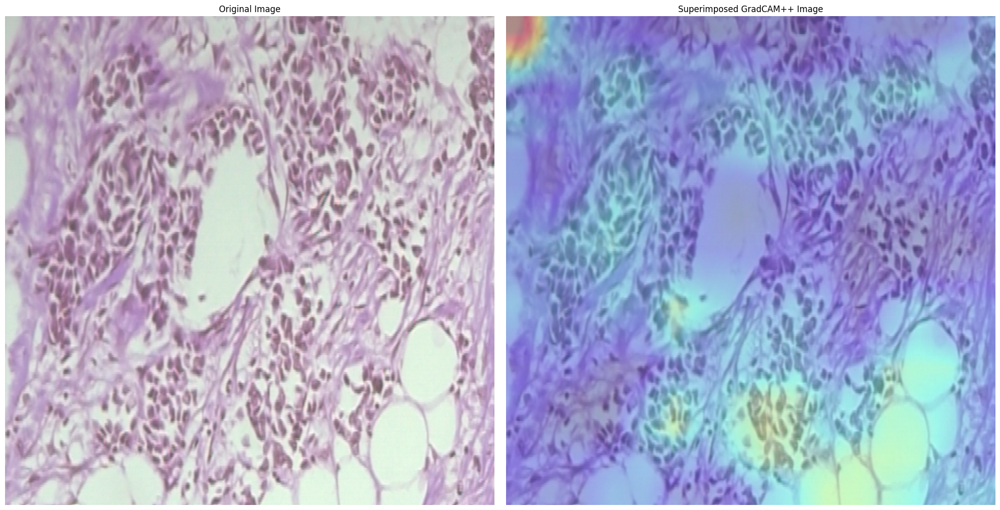

In [66]:
os.makedirs(save_dir, exist_ok=True)
grad_cam_result = generate_xai_gradcampp(resnet,fold_path_m,save_dir=save_dir)